<a href="https://colab.research.google.com/github/fcolombo7/AN2DL-2020/blob/main/Intro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# AN2DL - Image classification challenge

In [2]:
import os
import tensorflow as tf
import numpy as np
import pandas as pd

Configuration and constants

In [3]:
SEED = 1234
tf.random.set_seed(SEED)  

IMG_H, IMG_W = (512, 512) #IMAGE HEIGHT, IMAGE WIDTH
BS = 64 #BATCH SIZE

VALIDATION_SPLIT = 0.2
DATA_AUGMENTATION = True

## Data import and preprocessing

#### Import the *MaskDataset*

In [4]:
# Get current working directory
cwd = os.getcwd()
print(cwd)

/content


In [5]:
from google.colab import drive
drive.mount('/content/drive')

drive_root_folder = '/content/drive/My Drive/ANN_project/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Check if the dataset has been already processed, otherwise unzip it.

**N.B.**: we are unzipping in the `/content` folder and not in `drive`.  
If you want to unzip in your drive folder, write `os.chdir(drive_root_folder)`



In [6]:
#check if the dataset is already available
if not os.path.exists(cwd+'/MaskDataset'):
  !unzip '/content/drive/My Drive/ANN_project/artificial-neural-networks-and-deep-learning-2020.zip'
else:
  print('MaskDataset already loaded')

MaskDataset already loaded


#### Data preprocessing

##### Check dataset image *size* using `PIL`

In [7]:
import pathlib
path = os.path.join(cwd, 'MaskDataset') 
data_dir = pathlib.Path(path)
training_images = list(data_dir.glob('training/*'))

In [8]:
print(f"number of images: {len(training_images)}")

number of images: 5614


In [9]:
import PIL

image_sizes = set() #unique sizes
for image in training_images:
  image_sizes.add(PIL.Image.open(str(image)).size)
print(f"number of unique sizes: {len(image_sizes)}")

number of unique sizes: 275


In [10]:
#explore some of them
size_iter = iter(image_sizes)
for i in range(15):
  print(i, next(size_iter))

0 (612, 423)
1 (612, 508)
2 (427, 612)
3 (612, 326)
4 (345, 612)
5 (612, 552)
6 (612, 434)
7 (612, 463)
8 (434, 612)
9 (612, 397)
10 (612, 566)
11 (612, 408)
12 (612, 469)
13 (612, 354)
14 (463, 612)


##### Set up the `ImageDataGenerator` and split the dataset 

Definition of the `ImageDataGenerator` for _data augmentation_:

In [11]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create training ImageDataGenerator object
if DATA_AUGMENTATION:
    train_data_gen = ImageDataGenerator(rotation_range=10,
                                        width_shift_range=10,
                                        height_shift_range=10,
                                        zoom_range=0.3,
                                        horizontal_flip=True,
                                        brightness_range = [0.7, 1.35],
                                        channel_shift_range=0.2,
                                        fill_mode='nearest',
                                        rescale=1./255,
                                        validation_split=VALIDATION_SPLIT)
else:
    train_data_gen = ImageDataGenerator(rescale=1./255,
                                        validation_split=VALIDATION_SPLIT)

Define the *train* and *validation* dataset through the `pandas` library:

In [12]:
import json

dataset_dir = os.path.join(cwd, "MaskDataset")
training_dir = os.path.join(dataset_dir, "training")
with open(os.path.join(dataset_dir,"train_gt.json")) as f:
  dic = json.load(f)
  dataframe = pd.DataFrame(dic.items())
  dataframe.rename(columns = {0:'filename', 1:'class'}, inplace = True)
  dataframe["class"] = dataframe["class"].astype('string')
  train_gen = train_data_gen.flow_from_dataframe(dataframe,
                                               training_dir,
                                               batch_size=BS,
                                               target_size=(IMG_H, IMG_W),
                                               class_mode='categorical',
                                               shuffle=True,
                                               seed=SEED,
                                               subset = 'training')
  
  validation_gen = train_data_gen.flow_from_dataframe(dataframe,
                                               training_dir,
                                               batch_size=BS,
                                               target_size=(IMG_H, IMG_W),
                                               class_mode='categorical',
                                               shuffle=True,
                                               seed=SEED,
                                               subset = 'validation')

Found 4492 validated image filenames belonging to 3 classes.
Found 1122 validated image filenames belonging to 3 classes.


##### Train images exploration

In [13]:
visualize = True

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

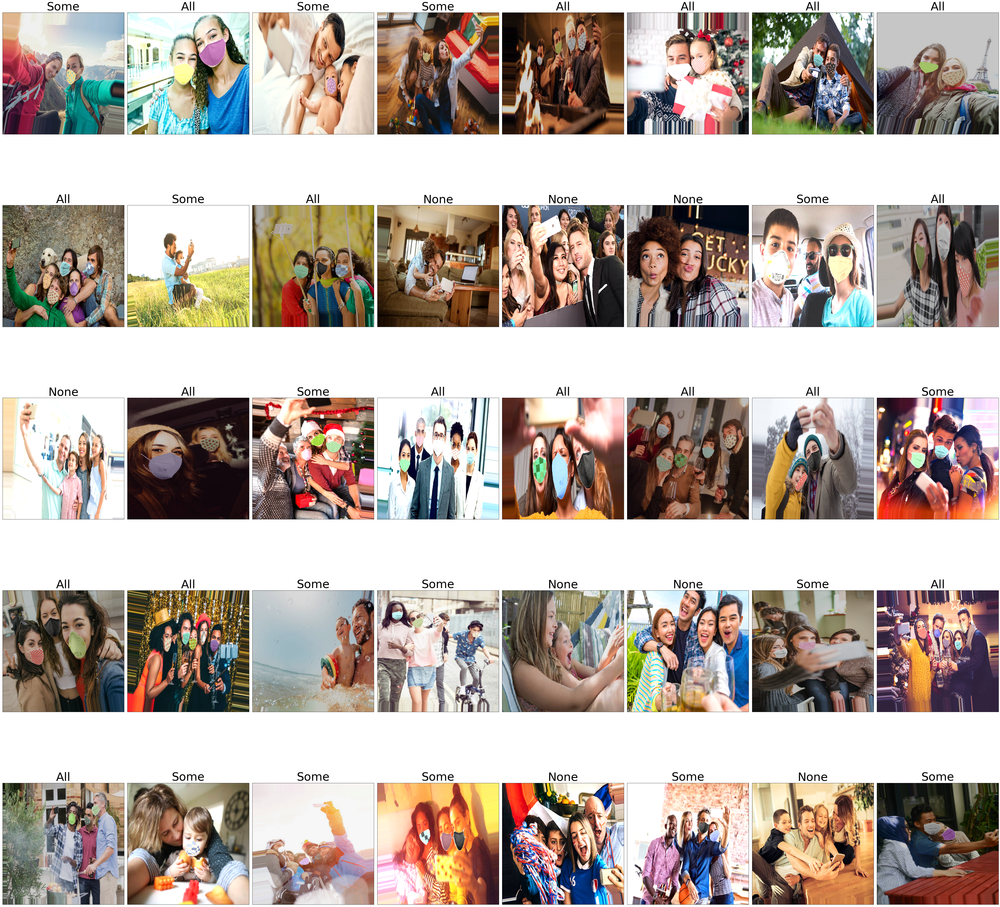

In [15]:
import matplotlib.pyplot as plt
%matplotlib inline

if visualize:
  x_batch, y_batch = next(train_gen)

  classes = np.array(["None", "All", "Some"])

  axes=[]
  fig=plt.figure(figsize=(60, 60))

  for i in range(5*8):
    img = x_batch[i]
    axes.append( fig.add_subplot(5, 8, i+1) )
    subplot_title=(classes[y_batch[i].nonzero()][0])
    axes[-1].set_title(subplot_title, fontsize=50)  
    plt.xticks([])
    plt.yticks([])
    plt.grid=False
    plt.imshow(img)
  fig.tight_layout()    
  plt.show();

#### Dobbiamo aggiungere una sezione su `Test Set Exploration`?